<a href="https://colab.research.google.com/github/AnaisGuillem/historicplacesmerced/blob/master/ImageSegmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installations

## Installing Dependencies

In [1]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
#we also need opencv but is already installed in google colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 2.1MB/s 
  Found existing installation: torch 1.5.1+cu101
    Uninstalling torch-1.5.1+cu101:
      Successfully uninstalled torch-1.5.1+cu101
  Found existing installation: torchvision 0.6.1+cu101
    Uninstalling torchvision-0.6.1+cu101:
      Successfully uninstalled torchvision-0.6.1+cu101
1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



## Install Detectron2

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 503kB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1.post20200716-cp36-none-any.whl size=42325 sha256=20eae7fbefcc2f82613be9b0549bac62b80171b3eaaa1eef92aa9579d43a65d3
  Stored in directory: /root/.cache/pip/wheels/81/99/f4/42a6bef61c07b3d78dfe6d7ebff259444c4526504cf72378d7
Successfully built fvcore


## Import Libraries and utilities

In [143]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow
# import webcolors
from PIL import Image, ImageDraw, ImageChops

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

import matplotlib.pyplot as plt
import math


In [2]:
!git clone https://github.com/facebookresearch/detectron2

Cloning into 'detectron2'...
remote: Enumerating objects: 6127, done.
remote: Total 6127 (delta 0), reused 0 (delta 0), pack-reused 6127
Receiving objects: 100% (6127/6127), 2.79 MiB | 19.55 MiB/s, done.
Resolving deltas: 100% (4447/4447), done.


# Preprocessing

## Transform data to coco format

In [4]:
pip install labelme2coco

In [6]:
# import package
import labelme2coco

# set directory that contains labelme annotations and image files
labelme_folder = "/content/House Segmentation/test"

# set path for coco json to be saved
save_json_path = "/content/House Segmentation/test.json"

# convert labelme annotations to coco
labelme2coco.convert(labelme_folder, save_json_path)

# Custom datasets

## Register

In [7]:
!ls "House Segmentation"

test  test.json  train	train.json


In [8]:
from detectron2.data.datasets import register_coco_instances

for d in ["train", "test"]:
    register_coco_instances(f"house_{d}", {}, f"House Segmentation/{d}.json", f"House Segmentation/{d}")

[07/26 00:50:00 d2.data.datasets.coco]: Loaded 240 images in COCO format from House Segmentation/train.json


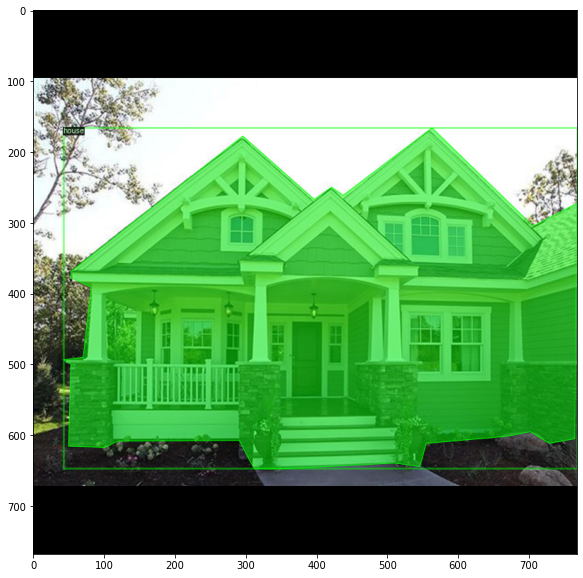

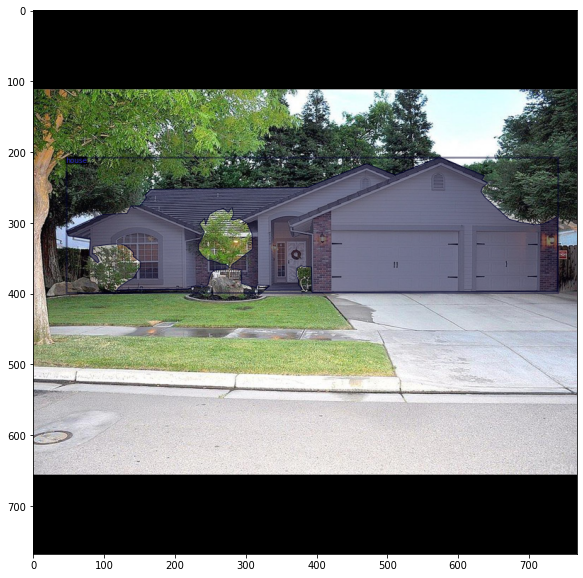

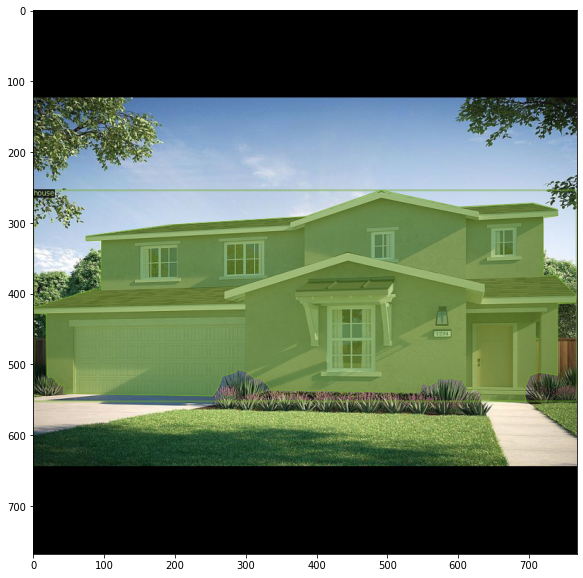

In [9]:
import random
from detectron2.data import DatasetCatalog, MetadataCatalog

dataset_dicts = DatasetCatalog.get("house_train")
house_metadata = MetadataCatalog.get("house_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=house_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

## Train 

In [10]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("house_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[07/26 00:56:38 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_2d9806.pkl: 431MB [00:17, 24.8MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[07/26 00:57:04 d2.engine.train_loop]: Starting training from iteration 0
[07/26 00:57:19 d2.utils.events]:  eta: 0:11:18  iter: 19  total_loss: 1.627  loss_cls: 0.700  loss_box_reg: 0.048  loss_mask: 0.692  loss_rpn_cls: 0.179  loss_rpn_loc: 0.015  time: 0.6911  data_time: 0.0276  lr: 0.000005  max_mem: 4257M
[07/26 00:57:33 d2.utils.events]:  eta: 0:11:01  iter: 39  total_loss: 1.498  loss_cls: 0.587  loss_box_reg: 0.037  loss_mask: 0.685  loss_rpn_cls: 0.168  loss_rpn_loc: 0.015  time: 0.6951  data_time: 0.0061  lr: 0.000010  max_mem: 4257M
[07/26 00:57:46 d2.utils.events]:  eta: 0:10:44  iter: 59  total_loss: 1.281  loss_cls: 0.402  loss_box_reg: 0.046  loss_mask: 0.670  loss_rpn_cls: 0.152  loss_rpn_loc: 0.015  time: 0.6863  data_time: 0.0059  lr: 0.000015  max_mem: 4257M
[07/26 00:58:00 d2.utils.events]:  eta: 0:10:34  iter: 79  total_loss: 1.103  loss_cls: 0.283  loss_box_reg: 0.050  loss_mask: 0.650  loss_rpn_cls: 0.087  loss_rpn_loc: 0.013  time: 0.6931  data_time: 0.0061  lr:

## Training Curves

In [11]:
# Training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Test model

In [12]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
cfg.DATASETS.TEST = ("house_test", )
predictor = DefaultPredictor(cfg)

[07/26 01:12:49 d2.data.datasets.coco]: Loaded 24 images in COCO format from House Segmentation/test.json


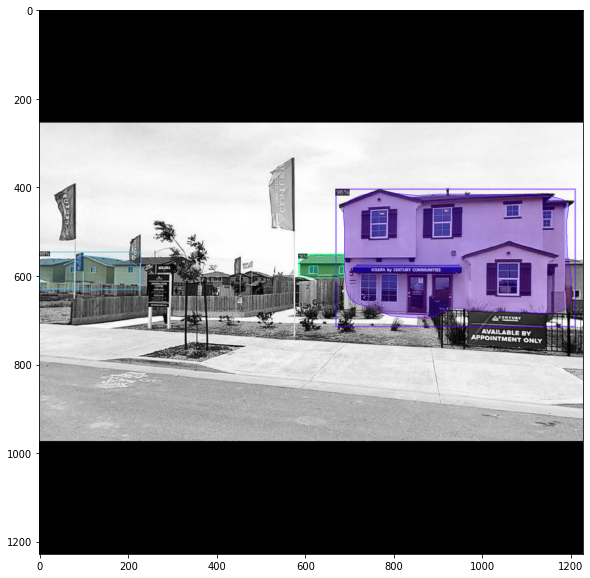

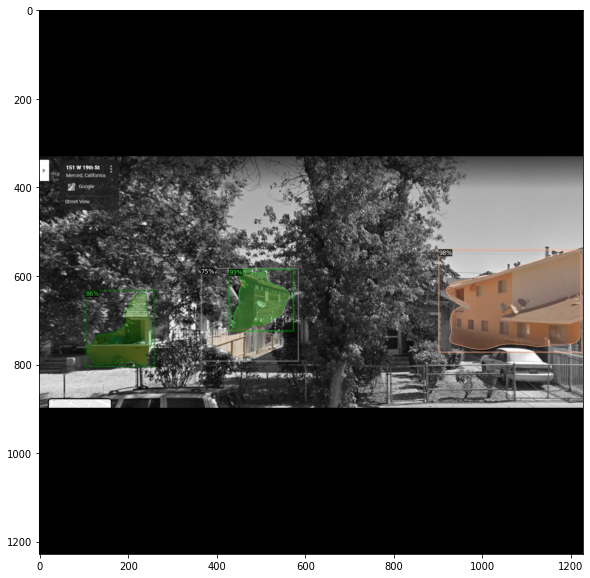

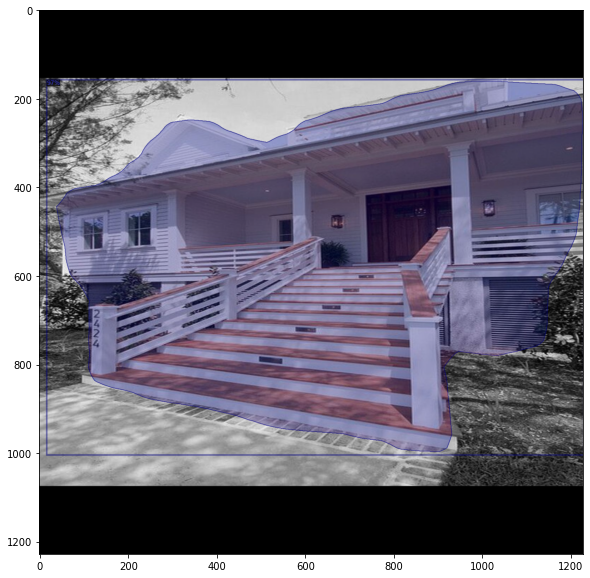

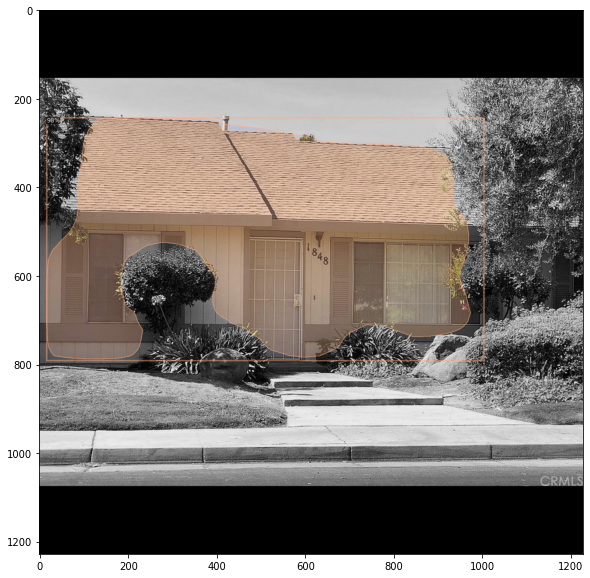

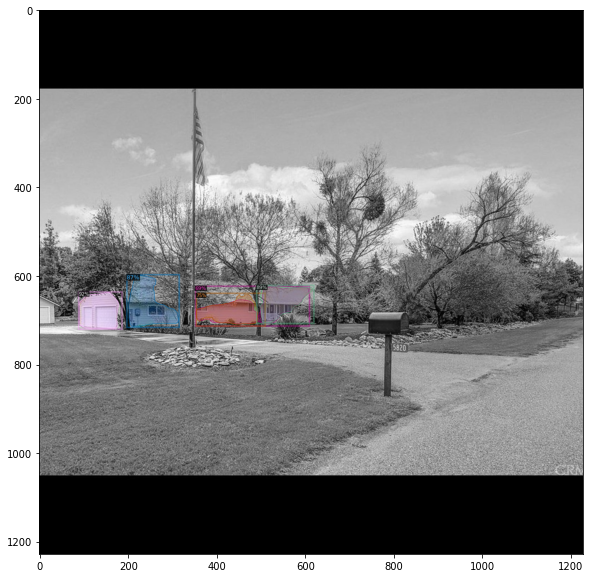

...

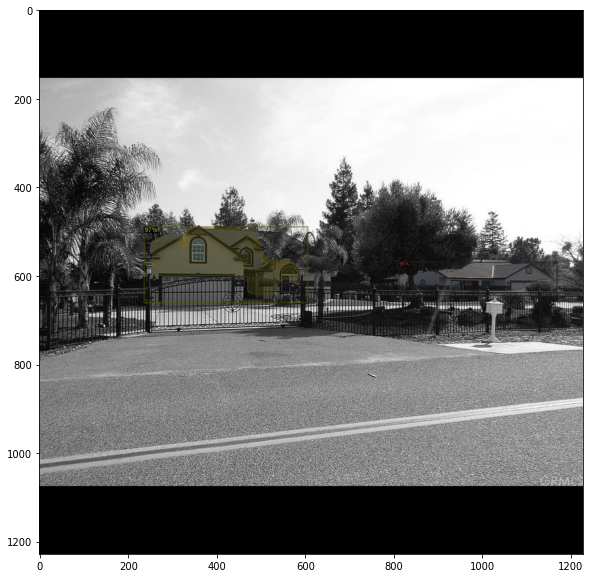

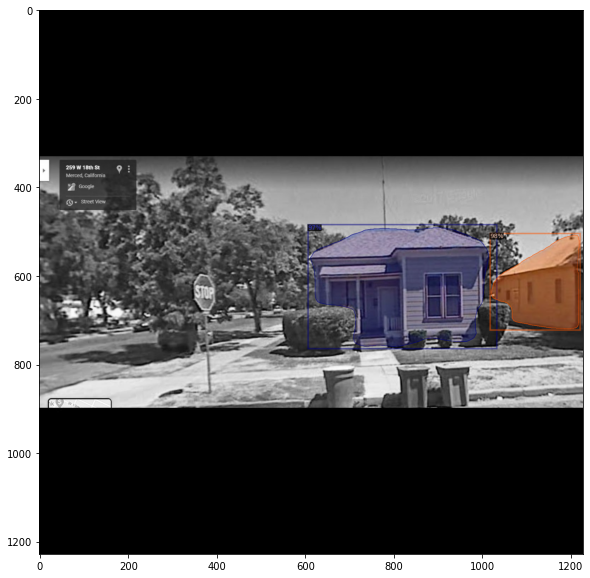

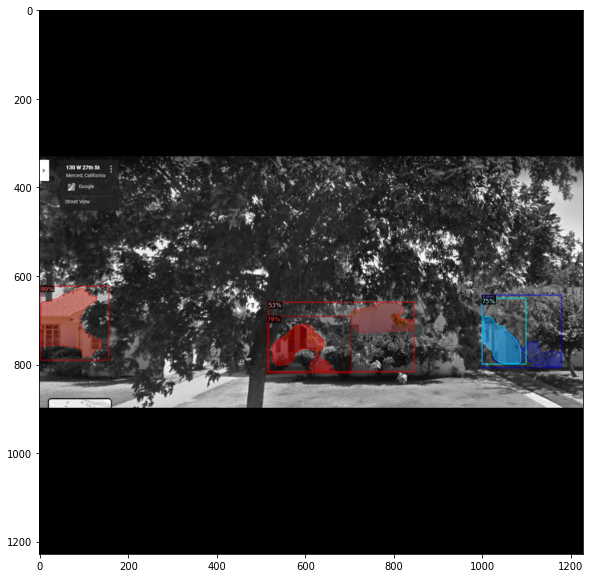

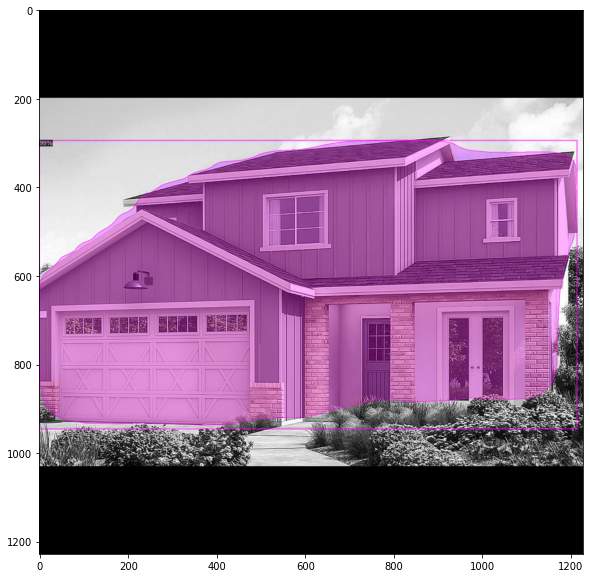

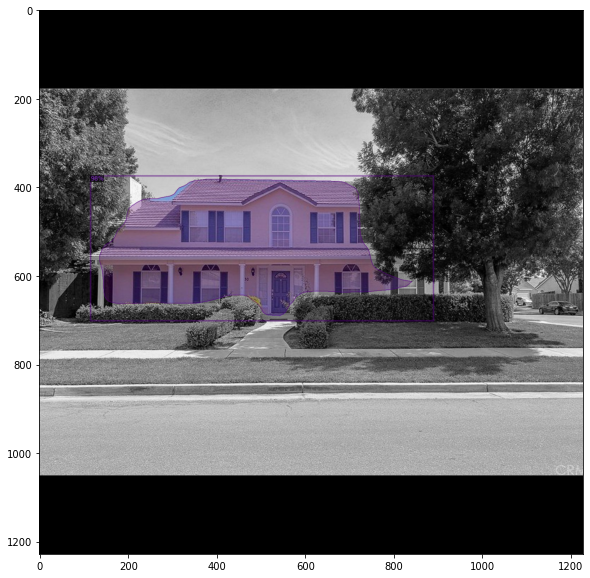

In [13]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("house_test")
for d in random.sample(dataset_dicts, 24):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=house_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

## Evaluation

In [14]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("house_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "house_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way is to use trainer.test

[07/26 01:14:30 d2.data.datasets.coco]: Loaded 24 images in COCO format from House Segmentation/test.json
[07/26 01:14:30 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   house    | 45           |
|            |              |
[07/26 01:14:30 d2.data.common]: Serializing 24 elements to byte tensors and concatenating them all ...
[07/26 01:14:30 d2.data.common]: Serialized dataset takes 0.03 MiB
[07/26 01:14:30 d2.evaluation.evaluator]: Start inference on 24 images
[07/26 01:14:33 d2.evaluation.evaluator]: Inference done 11/24. 0.1589 s / img. ETA=0:00:02
[07/26 01:14:36 d2.evaluation.evaluator]: Total inference time: 0:00:04.101019 (0.215843 s / img per device, on 1 devices)
[07/26 01:14:36 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:02 (0.157090 s / img per device, on 1 devices)
[07/26 01:14:36 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[07/26 01:14:36 d2.e

# Segmentation

## Loading Images

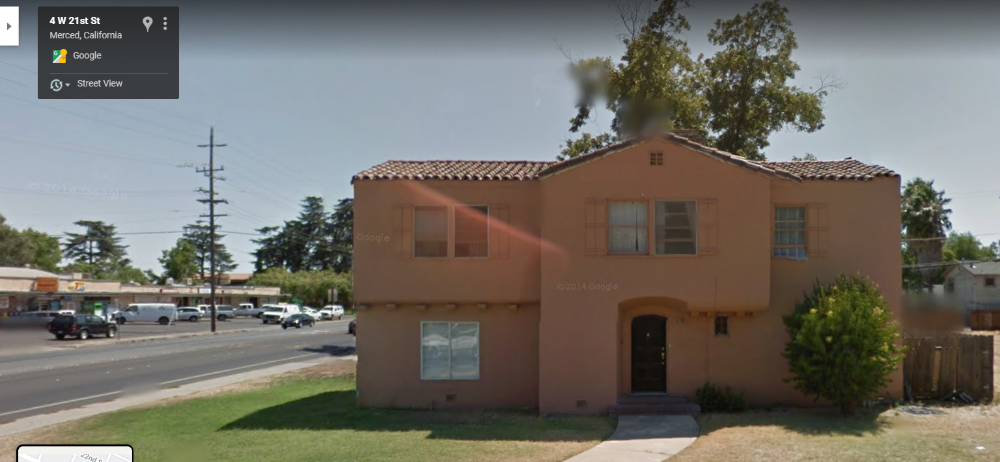

In [15]:
path = '/content/4_West_21st_Street_Jul2012.jpg'
img = cv2.imread(path) 
cv2_imshow(img)

Create metadata

## Using the Instance Segmentation Pretrained Model

In [18]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(img)

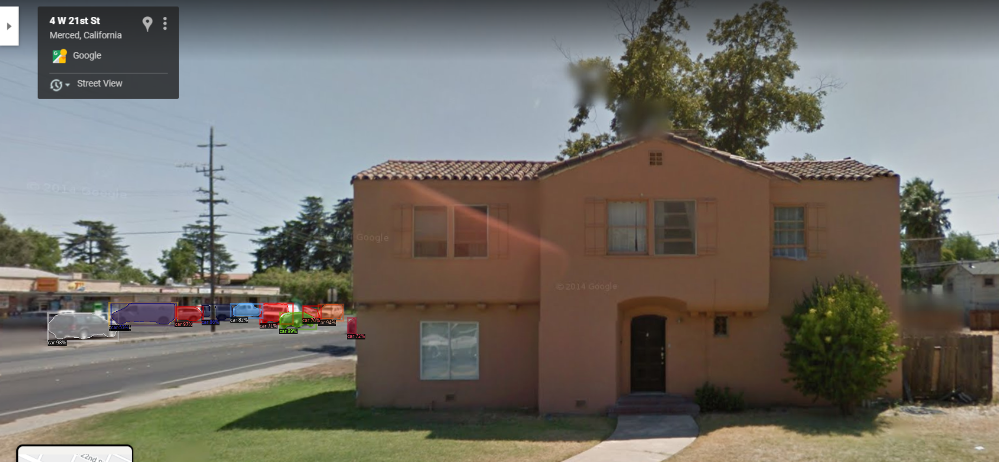

In [21]:
v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

## Panoptic segmentation

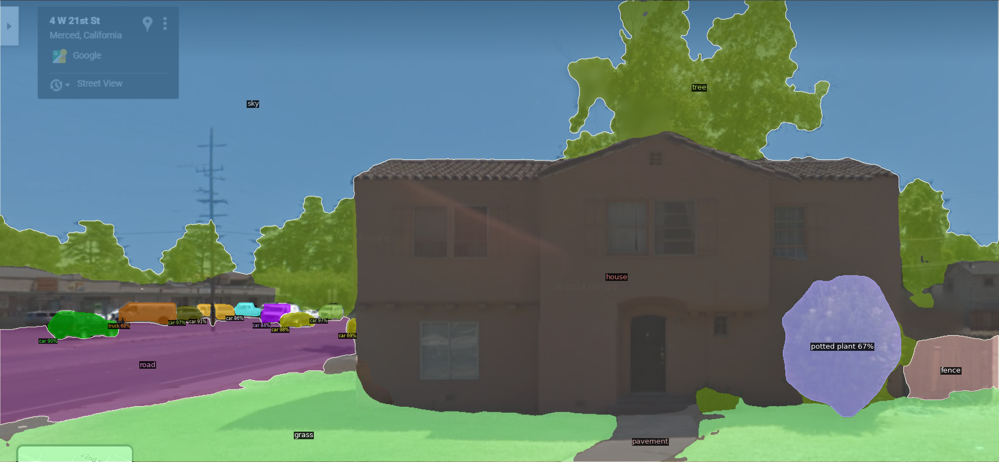

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(img)["panoptic_seg"]
v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(out.get_image()[:, :, ::-1])
outputs = predictor(img)

## Using Instance Segmentation Final Model trained with custom dataset

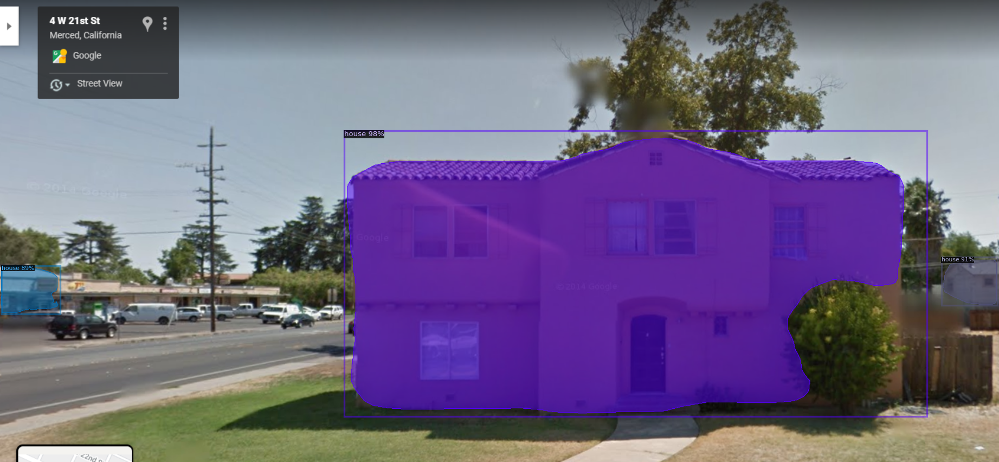

In [134]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set threshold for this model
cfg.MODEL.WEIGHTS = "./output/model_final.pth"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
predictor = DefaultPredictor(cfg)
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1], my_metadata, scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [210]:
from detectron2.data.catalog import Metadata
my_metadata = Metadata()
my_metadata.set(thing_classes = ['house', 'x'])

Metadata(thing_classes=['house', 'x'])

Outputs

In [209]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([0, 0, 0], device='cuda:0')
Boxes(tensor([[ 528.9909,  201.5377, 1424.9077,  639.9433],
        [1447.2979,  395.7902, 1533.4100,  469.7523],
        [   2.1414,  408.5529,   92.0967,  483.1002]], device='cuda:0'))


# Data extraction 

## Output instances 

In [136]:
for data in outputs["instances"].pred_classes:
  num = data.item()
  print(my_metadata.thing_classes[num])

house
house
house


## Get instance image


In [137]:
masks = outputs["instances"].pred_masks.cpu().numpy()
boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()

In [101]:
print(outputs["instances"].pred_masks.cpu().numpy()[0])
print(outputs["instances"].pred_boxes.tensor.cpu().numpy()[0])

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
[ 528.9909   201.53773 1424.9077   639.9433 ]


### Show full box

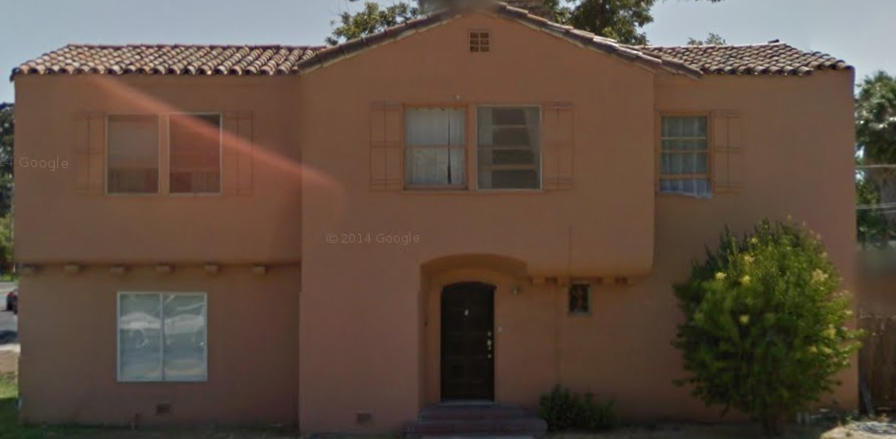

In [213]:
mask = outputs["instances"].pred_masks.cpu().numpy()[0]
box = outputs["instances"].pred_boxes.tensor.cpu().numpy()[0]
mask_h = int(math.ceil(box[3] - box[1]))
mask_w = int(math.ceil(box[2] - box[0]))

orign_img = np.array(Image.fromarray(cv2.imread('4_West_21st_Street_Jul2012.jpg')))

temp_mask = np.zeros((mask_h, mask_w))
for h_idx in range(int(box[1]), int(box[3])):
  for w_idx in range(int(box[0]), int(box[2])):
    temp_mask[h_idx - int(box[1])][w_idx -int(box[0])] = mask[h_idx][w_idx]

temp_mask_ints = temp_mask.astype(int)
temp_mask_fill = np.zeros((mask_h, mask_w, 4))

for h_idx, h_bw in enumerate(temp_mask_ints):
  for w_idx, w_bw in enumerate(h_bw):
    orig_w = int(math.ceil(w_idx + box[0]))
    orig_h = int(math.ceil(h_idx + box[1]))
    temp_mask_fill[h_idx][w_idx] = np.append(orign_img[orig_h, orig_w], 1)
cv2_imshow(temp_mask_fill[:,:,0:3])

### Show full mask

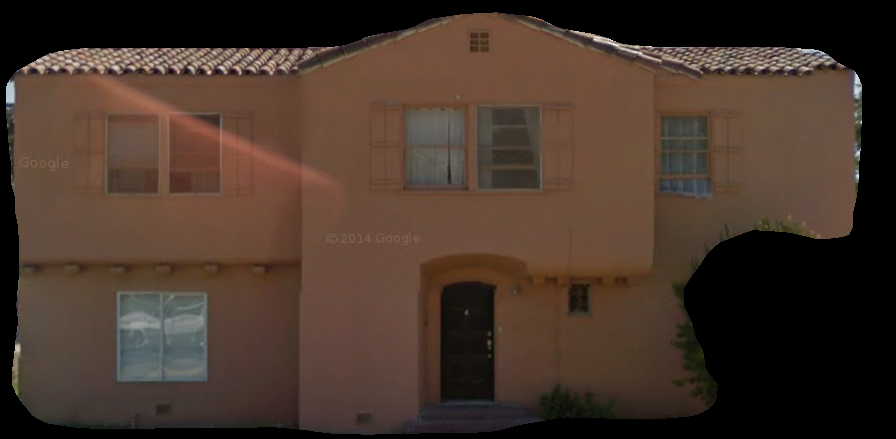

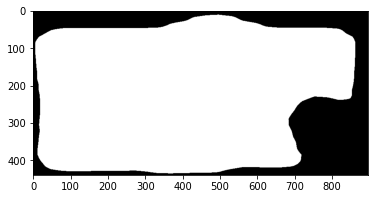

In [211]:
mask = outputs["instances"].pred_masks.cpu().numpy()[0]
box = outputs["instances"].pred_boxes.tensor.cpu().numpy()[0]
mask_h = int(math.ceil(box[3] - box[1]))
mask_w = int(math.ceil(box[2] - box[0]))

orign_img = np.array(Image.fromarray(cv2.imread('4_West_21st_Street_Jul2012.jpg')))

temp_mask = np.zeros((mask_h, mask_w))
for h_idx in range(int(box[1]), int(box[3])):
  for w_idx in range(int(box[0]), int(box[2])):
    temp_mask[h_idx - int(box[1])][w_idx -int(box[0])] = mask[h_idx][w_idx]

temp_mask_ints = temp_mask.astype(int)
temp_mask_fill = np.zeros((mask_h, mask_w, 4))

for h_idx, h_bw in enumerate(temp_mask_ints):
  for w_idx, w_bw in enumerate(h_bw):
    if (w_bw == 0):
      temp_mask_fill[h_idx][w_idx] = [0, 0, 0, 0]
    else:
      orig_w = int(math.ceil(w_idx + box[0]))
      orig_h = int(math.ceil(h_idx + box[1]))
      temp_mask_fill[h_idx][w_idx] = np.append(orign_img[orig_h, orig_w], 1)

plt.imshow(temp_mask, cmap='gray')
cv2_imshow(temp_mask_fill[:,:,0:3])

*ISSUE: get_mask_image() function 

In [ ]:
# mask_arr = []
# for index, mask in enumerate(masks):
#   mask_arr.append(get_mask_image(mask, boxes[index], img))
blah = get_mask_image(masks[0], boxes[0], img)
print(blah)
cv2_imshow(blah[:,:,0:3])

In [ ]:
def get_mask_image(mask, box, orign_img):
  mask = outputs["instances"].pred_masks.cpu().numpy()[0]
  box = outputs["instances"].pred_boxes.tensor.cpu().numpy()[0] 

  mask_h = int(math.ceil(box[3] - box[1]))
  mask_w = int(math.ceil(box[2] - box[0]))

  orig_arr_img = np.array(Image.fromarray(orign_img))

  temp_mask = np.zeros((mask_h, mask_w))
  for h_idx in range(int(box[1]), int(box[3])):
    for w_idx in range(int(box[0]), int(box[2])):
      temp_mask[h_idx - int(box[1])][w_idx - int(box[0])] = mask[h_idx][w_idx]

  temp_mask_ints = temp_mask.astype(int)
  temp_mask_fill = np.zeros((mask_h, mask_w, 4))

for h_idx, h_bw in enumerate(temp_mask_ints):
  for w_idx, w_bw in enumerate(h_bw):
    # if (w_bw == 0):
    #   temp_mask_fill[h_idx][w_idx] = [0, 0, 0, 0]
    # else:
    orig_w = int(math.ceil(w_idx + box[0]))
    orig_h = int(math.ceil(h_idx + box[1]))
    temp_mask_fill[h_idx][w_idx] = np.append(orig_arr_img[orig_h][orig_w], 1)

return temp_mask_fill

**ISSUE: pred_masks is not defined in panoptic_seg **

In [ ]:
masks = outputs["panoptic_seg"].pred_masks.cpu().numpy()
print(masks)

### Finding the category_id of each mask

In [ ]:
print("Segment information: ", segments_info)
print("Categories ids: ")
for data in segments_info:
  print("               ", data.get("category_id"))
  # print(segments_info[i]["category_id"]) is an alternative 


Segment information:  [{'id': 1, 'isthing': True, 'score': 0.9728285074234009, 'category_id': 2, 'instance_id': 0, 'area': 337.0}, {'id': 2, 'isthing': True, 'score': 0.874255359172821, 'category_id': 58, 'instance_id': 1, 'area': 13228.0}, {'id': 3, 'isthing': True, 'score': 0.8603115677833557, 'category_id': 2, 'instance_id': 2, 'area': 129.0}, {'id': 4, 'isthing': False, 'category_id': 12, 'area': 139541.0}, {'id': 5, 'isthing': False, 'category_id': 37, 'area': 25387.0}, {'id': 6, 'isthing': False, 'category_id': 40, 'area': 45664.0}, {'id': 7, 'isthing': False, 'category_id': 44, 'area': 7052.0}]
Categories ids: 
                2
                58
                2
                12
                37
                40
                44


## Experimenting

In [ ]:
import sys
sys.path.append('/content/detectron2/demo')
import predictor
import demo
from predictor import VisualizationDemo

In [ ]:
 demo = VisualizationDemo(cfg)

In [ ]:
print(demo)

In [ ]:
predictions, visualized_output = demo.run_on_image(img)

In [ ]:
panoptic_stuff = predictions["panoptic_seg"]

In [ ]:
A_stuff = panoptic_stuff[0].cpu().data.numpy()
print(A_stuff)

[[15 15 15 ... 15 15 15]
 [15 15 15 ... 15 15 15]
 [15 15 15 ... 15 15 15]
 ...
 [17 17 17 ... 17 17 17]
 [17 17 17 ... 17 17 17]
 [17 17 17 ... 17 17 17]]


In [ ]:
cv2_imshow(A_stuff)

AttributeError: ignored

In [ ]:
print(demo.metadata.panoptic_json)

datasets/coco/annotations/panoptic_val2017.json


In [ ]:
for data in outputs["instances"].pred_classes:
    num = data.item()
    print(num, MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes[num])

2 car
2 car
2 car
2 car
2 car
2 car
2 car
2 car
2 car
7 truck
58 potted plant
2 car
2 car
2 car
7 truck
7 truck
2 car
7 truck
0 person
58 potted plant
2 car
2 car
2 car
2 car
0 person
2 car
2 car
2 car
2 car
2 car
2 car
5 bus
2 car


In [ ]:
for data outputs["panoptic_seg"].category_id
  num = data.item()
  print(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).stuff_classes[num])

SyntaxError: ignored